# Clustering of Cancer cells

## Import

In [1]:
import os

import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

import torch
import scanpy as sc
import scarches as sca

 captum (see https://github.com/pytorch/captum).


In [2]:
ref_path = '/root/datos/maestria/netopaas/lung_scRNA/LUCA_model/hvg_integrated_scvi_scanvi_tumor_model_b128_lay4_h1024_raydefault_epocs300-300/'
surgeries = '/root/datos/maestria/netopaas/luca_explore/surgeries/'

In [3]:
ref_latent_base = sc.read(f'{ref_path}/ref_latent.h5ad')

In [12]:
ref_latent = ref_latent_base.copy()
ref_latent.obs = ref_latent.obs[['cell_type', 'batch']]
ref_latent

AnnData object with n_obs × n_vars = 402634 × 10
    obs: 'cell_type', 'batch'

### Whole adata

In [59]:
samples = adata.obs.groupby(['sample', 'dataset', 'uicc_stage']).size().reset_index()

samples[samples[0]!=0].groupby(['dataset', 'uicc_stage']).size()

dataset                           uicc_stage
Chen_Zhang_2020                   I              6
                                  II             0
                                  III            5
                                  III or IV      0
                                  IV             0
He_Fan_2021                       I              3
                                  II             2
                                  III            0
                                  III or IV      0
                                  IV             0
Kim_Lee_2020                      I              8
                                  II             1
                                  III            2
                                  III or IV      0
                                  IV             4
Lambrechts_Thienpont_2018_6149v1  I              0
                                  II             6
                                  III            0
                                  III

In [ ]:
adata = sc.read_h5ad('/root/datos/maestria/netopaas/luca/data/atlas/extended_tumor_hvg.h5ad')
adata_tumor = adata[adata.obs.cell_type_tumor.str.contains('Tumor'),:]
adata_tumor

We simply concatenate the scANVI integrated datasets and the do fine clustering of the tumor cells. But may be we consider epithelial cells too

## Concatenate

### Zuani

In [5]:
name = 'zuani'
q_latent = sc.read(f'{surgeries}/Zuani_99acc/query_latent.h5ad')
q_pred = pd.read_csv(f'{surgeries}/{name}_predicted.csv')
q_pred.set_index(['index'], inplace=True)
q_latent.obs = q_pred.loc[:,['cell_type_tumor', 'dataset']].rename(columns={'cell_type_tumor':'cell_type', 'dataset':'batch'})
q_latent.obs

,cell_type,batch
index,,
Zuani_AAACCCAAGCAACTTC-1,T cell CD8 activated,Zuani
Zuani_AAACCCAAGCGCTTCG-1,T cell CD8 activated,Zuani
Zuani_AAACCCAAGGCTAACG-1,T cell CD4,Zuani
Zuani_AAACCCACATAGGTTC-1,T cell CD4,Zuani
Zuani_AAACCCACATCCTTGC-1,T cell CD8 effector memory,Zuani
...,...,...
Zuani_TTTGATCAGTTGAATG-1,Plasma cell,Zuani
Zuani_TTTGATCGTCAGCTTA-1,Monocyte classical,Zuani
Zuani_TTTGGAGGTCACCCTT-1,transitional club/AT2,Zuani


In [6]:
ref_latent = ref_latent.concatenate(q_latent,batch_key=None)
ref_latent.obs

/tmp/ipykernel_13315/1171262394.py:1: FutureWarning: Use anndata.concat instead of AnnData.concatenate, AnnData.concatenate is deprecated and will be removed in the future. See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  ref_latent = ref_latent.concatenate(q_latent,batch_key=None)


,cell_type,batch
0-0,T cell CD8 effector memory,Chen_Zhang_2020
1-0,Tumor cells LUAD,Chen_Zhang_2020
2-0,B cell,Chen_Zhang_2020
3-0,B cell,Chen_Zhang_2020
4-0,Plasma cell,Chen_Zhang_2020
...,...,...
Zuani_TTTGATCAGTTGAATG-1-1,Plasma cell,Zuani
Zuani_TTTGATCGTCAGCTTA-1-1,Monocyte classical,Zuani
Zuani_TTTGGAGGTCACCCTT-1-1,transitional club/AT2,Zuani
Zuani_TTTGTTGAGTATGGAT-1-1,Tumor cells LUAD EMT,Zuani


### Bischoff

In [7]:
name = 'Bishoff'
q_latent = sc.read(f'{surgeries}/{name}/query_latent.h5ad')
q_pred = pd.read_csv(f'{surgeries}/{name}_predicted.csv')
q_pred.set_index(['index'], inplace=True)
q_pred.index = q_pred.index.astype(str) + f'_{name}'
q_latent.obs = q_pred.loc[:,['cell_type_tumor', 'dataset']].rename(columns={'cell_type_tumor':'cell_type', 'dataset':'batch'})
q_latent.obs

,cell_type,batch
index,,
0_Bishoff,T cell CD4,p033t
1_Bishoff,T cell CD8 effector memory,p033t
2_Bishoff,Tumor cells NSCLC mixed,p033t
3_Bishoff,T cell CD8 effector memory,p033t
4_Bishoff,Plasma cell,p033t
...,...,...
11615_Bishoff,Tumor cells LUAD,p019t
11616_Bishoff,Tumor cells LUAD,p019t
11617_Bishoff,T cell regulatory,p019t


In [8]:
ref_latent = ref_latent.concatenate(q_latent,batch_key=None)
ref_latent.obs

/tmp/ipykernel_13315/1171262394.py:1: FutureWarning: Use anndata.concat instead of AnnData.concatenate, AnnData.concatenate is deprecated and will be removed in the future. See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  ref_latent = ref_latent.concatenate(q_latent,batch_key=None)


,cell_type,batch
0-0-0,T cell CD8 effector memory,Chen_Zhang_2020
1-0-0,Tumor cells LUAD,Chen_Zhang_2020
2-0-0,B cell,Chen_Zhang_2020
3-0-0,B cell,Chen_Zhang_2020
4-0-0,Plasma cell,Chen_Zhang_2020
...,...,...
11615_Bishoff-1,Tumor cells LUAD,p019t
11616_Bishoff-1,Tumor cells LUAD,p019t
11617_Bishoff-1,T cell regulatory,p019t
11618_Bishoff-1,T cell CD8 effector memory,p019t


In [9]:
name= 'Bishoff'
filt = ref_latent.obs.index.str.contains(name)
ref_latent.obs.loc[filt, 'batch'] += f'_{name}'
ref_latent.obs

,cell_type,batch
0-0-0,T cell CD8 effector memory,Chen_Zhang_2020
1-0-0,Tumor cells LUAD,Chen_Zhang_2020
2-0-0,B cell,Chen_Zhang_2020
3-0-0,B cell,Chen_Zhang_2020
4-0-0,Plasma cell,Chen_Zhang_2020
...,...,...
11615_Bishoff-1,Tumor cells LUAD,p019t_Bishoff
11616_Bishoff-1,Tumor cells LUAD,p019t_Bishoff
11617_Bishoff-1,T cell regulatory,p019t_Bishoff
11618_Bishoff-1,T cell CD8 effector memory,p019t_Bishoff


### Deng

In [10]:
name = 'Deng'
q_latent = sc.read(f'{surgeries}/{name}/query_latent.h5ad')
q_pred = pd.read_csv(f'{surgeries}/{name}_predicted.csv')
q_pred.set_index(['index'], inplace=True)
q_pred.index = q_pred.index.astype(str) + f'_{name}'
q_latent.obs = q_pred.loc[:,['cell_type_tumor', 'dataset']].rename(columns={'cell_type_tumor':'cell_type', 'dataset':'batch'})
q_latent.obs

,cell_type,batch
index,,
0_Deng,Mast cell,P001
1_Deng,T cell CD8 effector memory,P001
2_Deng,T cell CD4,P001
3_Deng,T cell CD8 activated,P001
4_Deng,Mast cell,P001
...,...,...
421706_Deng,Macrophage,P049
421707_Deng,Plasma cell,P049
421708_Deng,B cell,P049


In [11]:
ref_latent = ref_latent.concatenate(q_latent,batch_key=None)
ref_latent.obs

/tmp/ipykernel_13315/1171262394.py:1: FutureWarning: Use anndata.concat instead of AnnData.concatenate, AnnData.concatenate is deprecated and will be removed in the future. See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  ref_latent = ref_latent.concatenate(q_latent,batch_key=None)


,cell_type,batch
0-0-0-0,T cell CD8 effector memory,Chen_Zhang_2020
1-0-0-0,Tumor cells LUAD,Chen_Zhang_2020
2-0-0-0,B cell,Chen_Zhang_2020
3-0-0-0,B cell,Chen_Zhang_2020
4-0-0-0,Plasma cell,Chen_Zhang_2020
...,...,...
421706_Deng-1,Macrophage,P049
421707_Deng-1,Plasma cell,P049
421708_Deng-1,B cell,P049
421709_Deng-1,T cell CD8 effector memory,P049


IF THE BATCH IS AT SAMPLE LEVEL WE ADD THE DATASET TO NO LOSE THAT INFO

In [12]:
filt = ref_latent.obs.index.str.contains(name)
ref_latent.obs.loc[filt, 'batch'] += f'_{name}'
ref_latent.obs

,cell_type,batch
0-0-0-0,T cell CD8 effector memory,Chen_Zhang_2020
1-0-0-0,Tumor cells LUAD,Chen_Zhang_2020
2-0-0-0,B cell,Chen_Zhang_2020
3-0-0-0,B cell,Chen_Zhang_2020
4-0-0-0,Plasma cell,Chen_Zhang_2020
...,...,...
421706_Deng-1,Macrophage,P049_Deng
421707_Deng-1,Plasma cell,P049_Deng
421708_Deng-1,B cell,P049_Deng
421709_Deng-1,T cell CD8 effector memory,P049_Deng


### Hu

In [13]:
name = 'Hu'
q_latent = sc.read(f'{surgeries}/{name}/query_latent.h5ad')
q_pred = pd.read_csv(f'{surgeries}/{name}_predicted.csv')
q_pred.set_index(['index'], inplace=True)
q_pred.index = q_pred.index.astype(str) + f'_{name}'
q_latent.obs = q_pred.loc[:,['cell_type_tumor', 'dataset']].rename(columns={'cell_type_tumor':'cell_type', 'dataset':'batch'})
q_latent.obs

,cell_type,batch
index,,
BD_immune01_612637_Hu,Tumor cells LUSC mitotic,BD_immune01
BD_immune01_698718_Hu,Tumor cells LUSC mitotic,BD_immune01
BD_immune01_509246_Hu,Tumor cells LUSC mitotic,BD_immune01
BD_immune01_101435_Hu,Tumor cells LUSC mitotic,BD_immune01
BD_immune01_400370_Hu,T cell CD8 dividing,BD_immune01
...,...,...
BD_immune13_111313_Hu,Tumor cells LUSC mitotic,BD_immune13
BD_immune13_791956_Hu,Macrophage,BD_immune13
BD_immune14_462072_Hu,B cell dividing,BD_immune14


In [14]:
ref_latent = ref_latent.concatenate(q_latent,batch_key=None)
ref_latent.obs

/tmp/ipykernel_13315/1171262394.py:1: FutureWarning: Use anndata.concat instead of AnnData.concatenate, AnnData.concatenate is deprecated and will be removed in the future. See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  ref_latent = ref_latent.concatenate(q_latent,batch_key=None)


,cell_type,batch
0-0-0-0-0,T cell CD8 effector memory,Chen_Zhang_2020
1-0-0-0-0,Tumor cells LUAD,Chen_Zhang_2020
2-0-0-0-0,B cell,Chen_Zhang_2020
3-0-0-0-0,B cell,Chen_Zhang_2020
4-0-0-0-0,Plasma cell,Chen_Zhang_2020
...,...,...
BD_immune13_111313_Hu-1,Tumor cells LUSC mitotic,BD_immune13
BD_immune13_791956_Hu-1,Macrophage,BD_immune13
BD_immune14_462072_Hu-1,B cell dividing,BD_immune14
BD_immune14_124095_Hu-1,B cell dividing,BD_immune14


IF THE BATCH IS AT SAMPLE LEVEL WE ADD THE DATASET TO NO LOSE THAT INFO

In [15]:
filt = ref_latent.obs.index.str.contains('Hu')

In [16]:
filt = ref_latent.obs.index.str.contains(name)
ref_latent.obs.loc[filt, 'batch'] += f'_{name}'
ref_latent.obs

,cell_type,batch
0-0-0-0-0,T cell CD8 effector memory,Chen_Zhang_2020
1-0-0-0-0,Tumor cells LUAD,Chen_Zhang_2020
2-0-0-0-0,B cell,Chen_Zhang_2020
3-0-0-0-0,B cell,Chen_Zhang_2020
4-0-0-0-0,Plasma cell,Chen_Zhang_2020
...,...,...
BD_immune13_111313_Hu-1,Tumor cells LUSC mitotic,BD_immune13_Hu
BD_immune13_791956_Hu-1,Macrophage,BD_immune13_Hu
BD_immune14_462072_Hu-1,B cell dividing,BD_immune14_Hu
BD_immune14_124095_Hu-1,B cell dividing,BD_immune14_Hu


## Subset

In [334]:
ref_latent.obs.cell_type.unique()

array(['T cell CD8 effector memory', 'Tumor cells LUAD', 'B cell',
       'Plasma cell', 'T cell regulatory', 'Plasma cell dividing',
       'T cell CD8 dividing', 'Mast cell', 'T cell NK-like', 'T cell CD4',
       'Macrophage', 'T cell CD8 terminally exhausted',
       'Alveolar cell type 2', 'NK cell', 'Monocyte classical',
       'Neutrophils', 'T cell CD8 naive', 'cDC2', 'Macrophage alveolar',
       'Tumor cells LUAD mitotic', 'transitional club/AT2',
       'T cell CD4 dividing', 'Alveolar cell type 1', 'pDC',
       'NK cell dividing', 'Tumor cells LUSC mitotic', 'Ciliated',
       'Endothelial cell capillary', 'T cell CD8 activated',
       'B cell dividing', 'Endothelial cell venous', 'cDC1',
       'myeloid dividing', 'Club', 'Monocyte non-classical',
       'ROS1+ healthy epithelial', 'stromal dividing', 'DC mature',
       'Fibroblast alveolar', 'Fibroblast peribronchial',
       'Tumor cells LUSC', 'Smooth muscle cell', 'Pericyte',
       'Fibroblast adventitial', 'Tumor 

In [17]:
ref_latent.obs['dataset'] = ref_latent.obs['batch']

filt = ref_latent.obs.index.str.contains('Hu')
ref_latent.obs.loc[filt, 'dataset'] = 'Hu'

filt = ref_latent.obs.index.str.contains('Deng')
ref_latent.obs.loc[filt, 'dataset'] = 'Deng'

filt = ref_latent.obs.index.str.contains('Bishoff')
ref_latent.obs.loc[filt, 'dataset'] = 'Bishoff'
ref_latent.obs

,cell_type,batch,dataset
0-0-0-0-0,T cell CD8 effector memory,Chen_Zhang_2020,Chen_Zhang_2020
1-0-0-0-0,Tumor cells LUAD,Chen_Zhang_2020,Chen_Zhang_2020
2-0-0-0-0,B cell,Chen_Zhang_2020,Chen_Zhang_2020
3-0-0-0-0,B cell,Chen_Zhang_2020,Chen_Zhang_2020
4-0-0-0-0,Plasma cell,Chen_Zhang_2020,Chen_Zhang_2020
...,...,...,...
BD_immune13_111313_Hu-1,Tumor cells LUSC mitotic,BD_immune13_Hu,Hu
BD_immune13_791956_Hu-1,Macrophage,BD_immune13_Hu,Hu
BD_immune14_462072_Hu-1,B cell dividing,BD_immune14_Hu,Hu
BD_immune14_124095_Hu-1,B cell dividing,BD_immune14_Hu,Hu


We wanna get all the cells that could be related to the neoplastic cells. That means epithelial derived. Manually selectign from the cell types above we arrive to:

### Import

In [24]:
! mkdir $surgeries/Subcluster

In [25]:
ref_latent.write_h5ad(f'{surgeries}/Subcluster/query_latent.h5ad')

# ref_latent = sc.read(f'{surgeries}/Subcluster/query_latent.h5ad')

In [26]:
epit_types = ['Alveolar cell type 1', 'Alveolar cell type 2',  'ROS1+ healthy epithelial', 'transitional club/AT2', 'Club', 'Ciliated']
epit_tumor_filter = np.logical_or(ref_latent.obs.cell_type.isin(epit_types), ref_latent.obs.cell_type.str.contains('Tumor'))
ref_latent_tumor = ref_latent[epit_tumor_filter]
# ref_latent_tumor.obs['celltype_batch'] = ref_latent_tumor.obs['cell_type'].astype(str) + "_" + ref_latent_tumor.obs['batch'].astype(str)

## UMAP

In [27]:
ref_latent_tumor

View of AnnData object with n_obs × n_vars = 189365 × 10
    obs: 'cell_type', 'batch', 'dataset'

In [28]:
sc.pp.neighbors(ref_latent_tumor,
                # n_pcs=30
               )
sc.tl.umap(ref_latent_tumor)

In [29]:
sc.tl.leiden(ref_latent_tumor, key_added="leiden_res0_25", resolution=0.25)
# sc.tl.leiden(ref_latent_tumor, key_added="leiden_res0_5", resolution=0.5)

/tmp/ipykernel_13315/2383314857.py:1: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(ref_latent_tumor, key_added="leiden_res0_25", resolution=0.25)


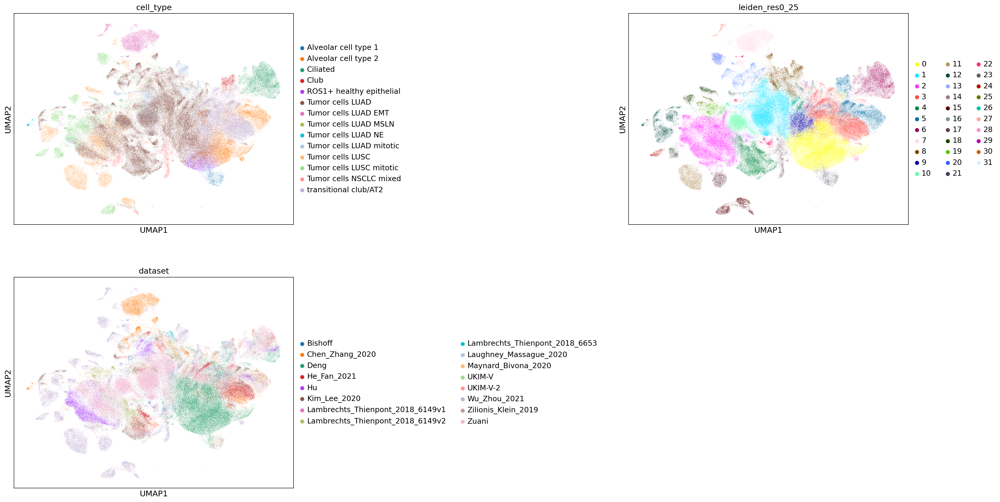

In [30]:
sc.set_figure_params(figsize=[7,7])
sc.pl.umap(ref_latent_tumor, ncols=2,color=['cell_type', 'leiden_res0_25', 'dataset'], wspace=1)

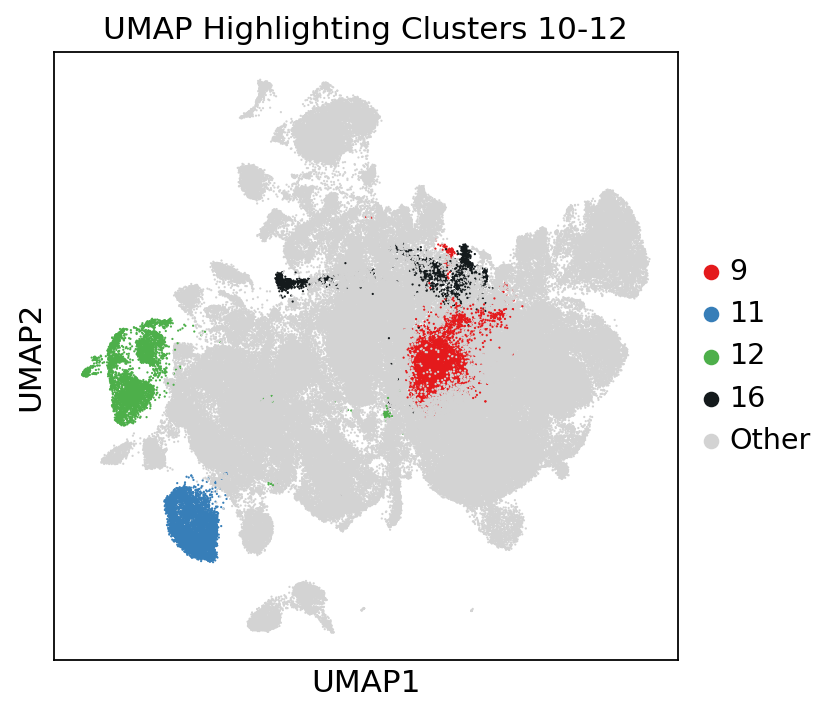

In [31]:
import matplotlib.pyplot as plt

clusters_to_highlight = ['16', '9', '11', '12'] 

# First, ensure that 'leiden_res0_25' is of string type for consistent comparison
ref_latent_tumor.obs['leiden_res0_25_str'] = ref_latent_tumor.obs['leiden_res0_25'].astype(str)

# Create the 'leiden_highlight' column
ref_latent_tumor.obs['leiden_highlight'] = ref_latent_tumor.obs['leiden_res0_25_str'].apply(
    lambda x: x if x in clusters_to_highlight else 'Other'
)

custom_palette = {
    '16': '#141a1c',    # Black
    '9': '#e41a1c',    # Red
    '11': '#377eb8',    # Blue
    '12': '#4daf4a',    # Green
    'Other': '#d3d3d3'   # Light Grey
}
# Step 4: Plot the UMAP with Custom Annotations
sc.set_figure_params(figsize=[5,5])
sc.pl.umap(
    ref_latent_tumor,
    color='leiden_highlight',
    palette=custom_palette,
    size=4,                      # Increased size for better visibility
    # legend_loc='right margin',    # Position the legend on the right
    # legend_fontsize=12,
    title='UMAP Highlighting Clusters 10-12'
)

## Contingency

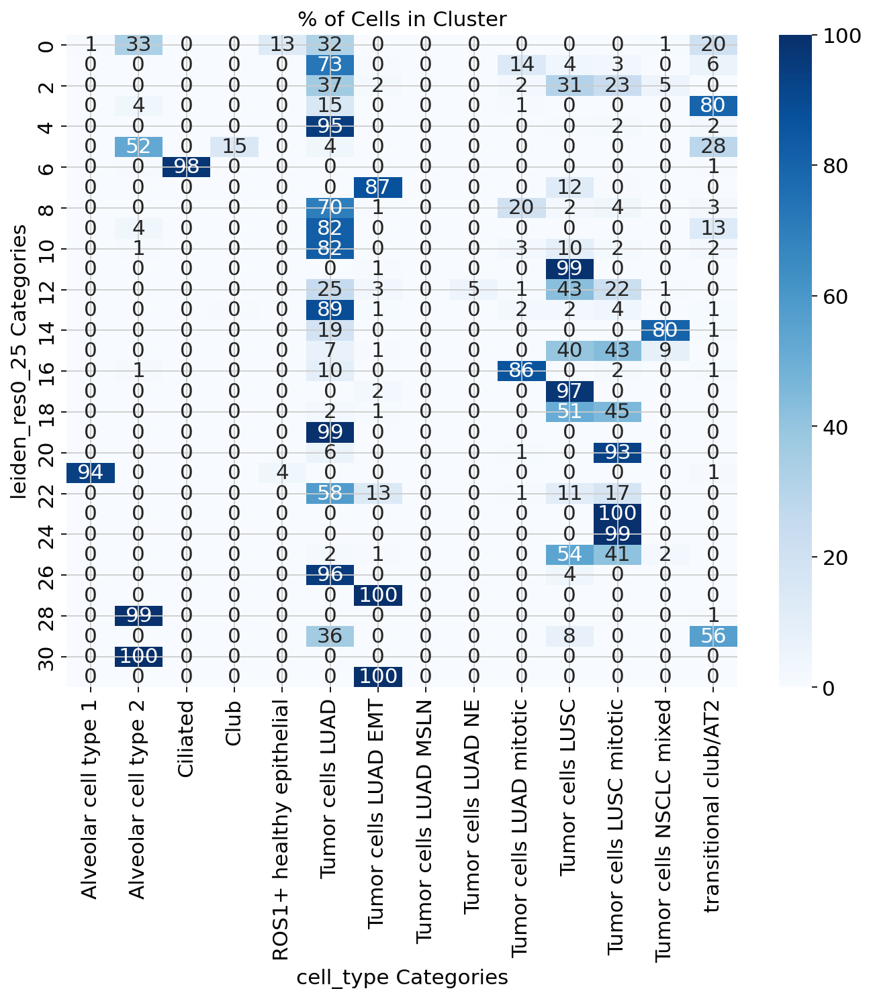

In [33]:
import anndata as ad
import numpy as np
import pandas as pd
from sklearn.metrics import confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming `adata` is your AnnData object and the two obs columns are 'col1' and 'col2'
# Replace 'col1' and 'col2' with your actual column names
col1 = 'leiden_res0_25'
col2 = 'cell_type'

# Extract the two columns from the obs dataframe
labels1 = ref_latent_tumor.obs[col1]
labels2 = ref_latent_tumor.obs[col2]

contingency_table = pd.crosstab(labels1, labels2)
# Normalize the table to get percentages
contingency_table_percentage = contingency_table.div(contingency_table.sum(axis=1), axis=0) * 100

# Visualize the matrix using seaborn
plt.figure(figsize=(10, 8))
sns.heatmap(contingency_table_percentage, annot=True, fmt='.0f', cmap='Blues')
plt.xlabel(f'{col2} Categories')
plt.ylabel(f'{col1} Categories')
plt.title('% of Cells in Cluster')
plt.show()


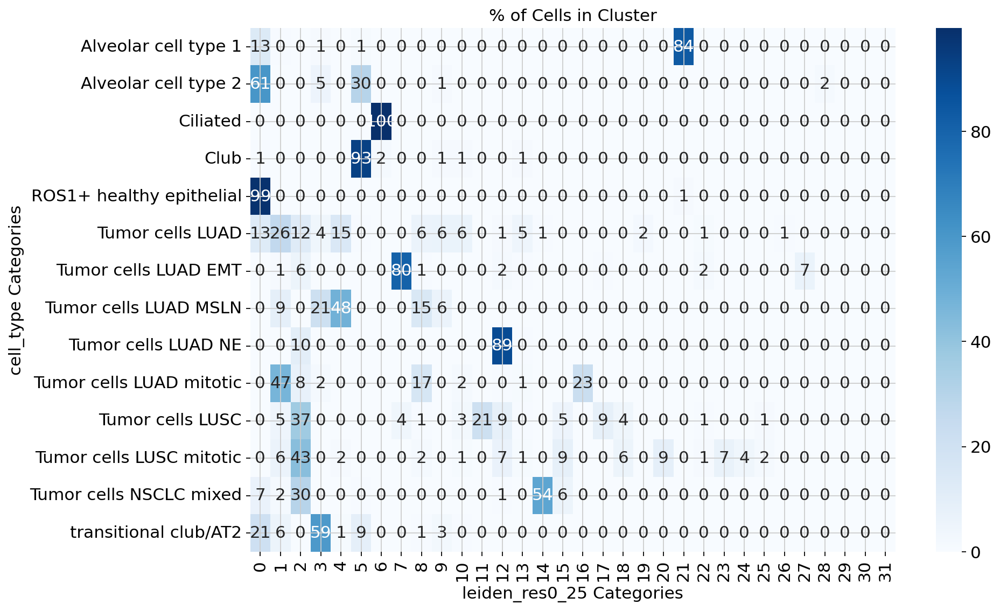

In [34]:
contingency_table_T = contingency_table.T
contingency_table_percentage_T = contingency_table_T.div(contingency_table_T.sum(axis=1), axis=0) * 100

# Visualize the matrix using seaborn
plt.figure(figsize=(12, 8))
sns.heatmap(contingency_table_percentage_T, annot=True, fmt='.0f', cmap='Blues')
plt.xlabel(f'{col1} Categories')
plt.ylabel(f'{col2} Categories')
plt.title('% of Cells in Cluster')
plt.show()

### Import

In [ ]:
ref_latent.write_h5ad(f'{surgeries}/Subcluster/query_latent.h5ad')

In [265]:
leiden_mapping = {
    0: 'Alveolar cell type 1', # We assing this to ROS1+ healthy eptihelial cells , because they may appear tumoral because some tumors have a mutation in ROS, but they are healthy. Mybe checki g if they do have ros1+ would be nce
    1: 'Tumor LUAD_mixed',
    2: 'Tumor LUAD_LUSC_mitotic',
    3: 'transitional club/AT2',
    4: 'Tumor LUAD_transitional',
    5: 'transitional club/AT2', # We pass this to transitional because it involves both instead of just at2. We ignore the cancer because things like ros1+ and others
    6: 'Tumor LUAD_mitotic', # has not that much just NSCLC
    7: 'Tumor LUAD_EMT1', # These are mostly isolated but we would like ti to be more mixed to have more interactions
    8: 'Ciliated',
    9: 'Tumor LUSC_mainly',
    10:'Tumor LUSC_LUAD_mitotic',
    11:'Tumor LUAD_LUSC',
    12:'Tumor LUAD_Club',
    13:'Tumor LUSC_mitotic2',
    14:'Club', # This is not that good and like with ROS1+.... our clustering is competing agianst our neural network and the NN should win
    15:'Tumor mitotic_LUSC',
    16:'Tumor LUSC_mainly2',
    17:'Tumor mixed_LUAD',
    18:'Tumor LUSC_mitotic',
    19:'Tumor mitotic_mixed',
    20:'Tumor LUAD_mainly1',
    21:'Tumor LUSC_mitotic',
    22:'Alveolar cell type 2',
    23:'Tumor LUAD_EMT2',
    24:'Tumor LUAD_EMT3',
    25:'Tumor LUAD_mainly2',
    26:'Alveolar cell type 2',
    27:'Tumor LUAD_EMT3',
}

Without Zuani

In [265]:
leiden_mapping = {
    0: 'Alveolar cell type 1', # We assing this to ROS1+ healthy eptihelial cells , because they may appear tumoral because some tumors have a mutation in ROS, but they are healthy. Mybe checki g if they do have ros1+ would be nce
    1: 'Tumor LUAD_mixed',
    2: 'Tumor LUAD_LUSC_mitotic',
    3: 'transitional club/AT2',
    4: 'Tumor LUAD_transitional',
    5: 'transitional club/AT2', # We pass this to transitional because it involves both instead of just at2. We ignore the cancer because things like ros1+ and others
    6: 'Tumor LUAD_mitotic', # has not that much just NSCLC
    7: 'Tumor LUAD_EMT1', # These are mostly isolated but we would like ti to be more mixed to have more interactions
    8: 'Ciliated',
    9: 'Tumor LUSC_mainly',
    10:'Tumor LUSC_LUAD_mitotic',
    11:'Tumor LUAD_LUSC',
    12:'Tumor LUAD_Club',
    13:'Tumor LUSC_mitotic2',
    14:'Club', # This is not that good and like with ROS1+.... our clustering is competing agianst our neural network and the NN should win
    15:'Tumor mitotic_LUSC',
    16:'Tumor LUSC_mainly2',
    17:'Tumor mixed_LUAD',
    18:'Tumor LUSC_mitotic',
    19:'Tumor mitotic_mixed',
    20:'Tumor LUAD_mainly1',
    21:'Tumor LUSC_mitotic',
    22:'Alveolar cell type 2',
    23:'Tumor LUAD_EMT2',
    24:'Tumor LUAD_EMT3',
    25:'Tumor LUAD_mainly2',
    26:'Alveolar cell type 2',
    27:'Tumor LUAD_EMT3',
}

In [271]:
ref_latent_tumor.obs['leiden_adjusted'] = ref_latent_tumor.obs['leiden_res0_25'].apply(lambda x: leiden_mapping[int(x)])
ref_latent_tumor.obs['leiden_adjusted']

1-0-0-0                            Tumor LUAD_Club
7-0-0-0                            Tumor LUAD_Club
14-0-0-0                           Tumor LUAD_Club
23-0-0-0                           Tumor LUAD_Club
25-0-0-0                           Tumor LUAD_Club
                                    ...           
BD_immune09_311353_Hu-1    Tumor LUAD_LUSC_mitotic
BD_immune10_52807_Hu-1         Tumor LUSC_mitotic2
BD_immune13_644587_Hu-1            Tumor LUAD_LUSC
BD_immune12_753660_Hu-1        Tumor LUSC_mitotic2
BD_immune13_111313_Hu-1    Tumor LUAD_LUSC_mitotic
Name: leiden_adjusted, Length: 148926, dtype: object

## Export new annots for each dataset

In [245]:
datasets = ['Hu', 'Bishoff','Zuani', 'Deng']
ref_latent.obs['dataset2'] = ref_latent.obs['dataset']

ref_latent.obs.loc[np.logical_not(ref_latent.obs['dataset'].isin(datasets)),'dataset2'] = 'Atlas'
ref_latent.obs

,cell_type,batch,dataset,dataset2
0-0-0-0,T cell CD8 effector memory,Chen_Zhang_2020,Chen_Zhang_2020,Atlas
1-0-0-0,Tumor cells LUAD,Chen_Zhang_2020,Chen_Zhang_2020,Atlas
2-0-0-0,B cell,Chen_Zhang_2020,Chen_Zhang_2020,Atlas
3-0-0-0,B cell,Chen_Zhang_2020,Chen_Zhang_2020,Atlas
4-0-0-0,Plasma cell,Chen_Zhang_2020,Chen_Zhang_2020,Atlas
...,...,...,...,...
BD_immune13_111313_Hu-1,Tumor cells LUSC mitotic,BD_immune13_Hu,Hu,Hu
BD_immune13_791956_Hu-1,Macrophage,BD_immune13_Hu,Hu,Hu
BD_immune14_462072_Hu-1,B cell dividing,BD_immune14_Hu,Hu,Hu
BD_immune14_124095_Hu-1,B cell dividing,BD_immune14_Hu,Hu,Hu


In [305]:
import numpy as np
import pandas as pd

# Step 1: Create a new column 'cell_type_adjusted' in ref_latent.obs
ref_latent.obs['cell_type_adjusted'] = ref_latent.obs['cell_type']

# Step 2: Identify tumor cells in ref_latent_tumor. We make the decision to 
# `steal` the epithelial cells from their just assignment. But we do not redistribute the epithelial cells according tou our cluster because, 
# Our scvi neural network trumps the clusters.
tumor_cells = ref_latent_tumor.obs.index[
    ref_latent_tumor.obs['leiden_adjusted'].str.contains('Tumor')
]

# Step 3: Overwrite predictions for tumor cells with Leiden clusters
ref_latent.obs.loc[tumor_cells, 'cell_type_adjusted'] = (
    ref_latent_tumor.obs.loc[tumor_cells, 'leiden_adjusted']
)

# Step 4: Export predictions for each dataset
datasets = ref_latent.obs['dataset2'].unique()

for ds in datasets:
    # Subset cells belonging to the current dataset
    cells_in_ds = ref_latent.obs[ref_latent.obs['dataset2'] == ds]
    
    # Create a DataFrame with cell IDs and adjusted cell types
    export_df = cells_in_ds[['cell_type_adjusted','cell_type','batch']].copy()
    export_df.reset_index(inplace=True)
    if ds in ['Hu', 'Bishoff', 'Deng', 'Zuani']:
        export_df['index'] = export_df['index'].str.split('_').str[:-1]
    # export_df.rename(columns={'index': 'cell_id'}, inplace=True)
    
    # Define the filename (adjust the path as needed)
    filename = f"{surgeries}/{ds}_predicted_leiden.csv"
    
    # Export to CSV
    export_df.to_csv(filename, index=False)
    
    print(f"Exported predictions for dataset '{ds}' to '{filename}'")


Exported predictions for dataset 'Atlas' to '/root/datos/maestria/netopaas/luca_explore/surgeries//Atlas_predicted_leiden.csv'
Exported predictions for dataset 'Bishoff' to '/root/datos/maestria/netopaas/luca_explore/surgeries//Bishoff_predicted_leiden.csv'
Exported predictions for dataset 'Deng' to '/root/datos/maestria/netopaas/luca_explore/surgeries//Deng_predicted_leiden.csv'
Exported predictions for dataset 'Hu' to '/root/datos/maestria/netopaas/luca_explore/surgeries//Hu_predicted_leiden.csv'


## Witout ZUani

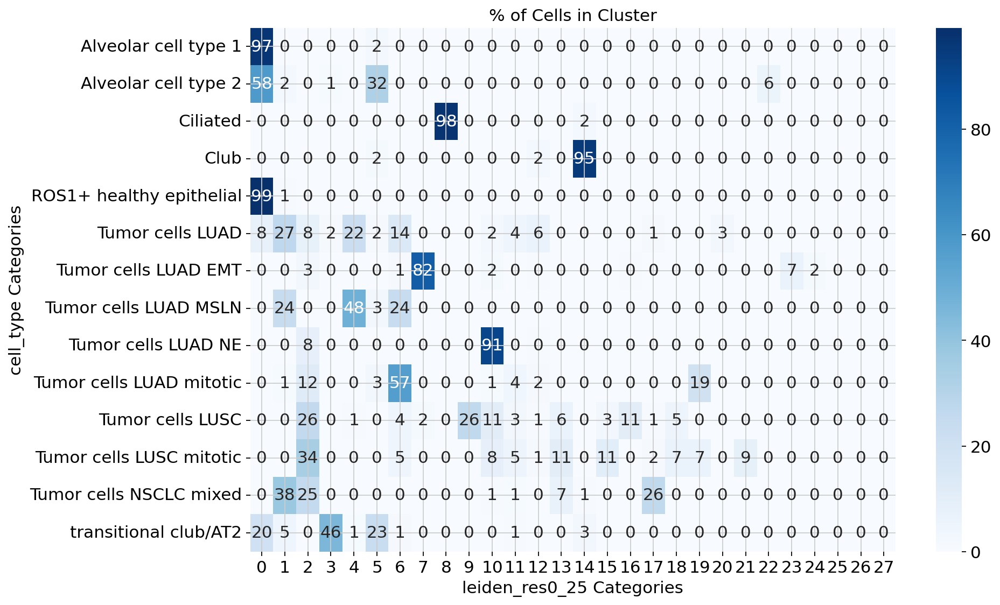

In [251]:
contingency_table_T = contingency_table.T
contingency_table_percentage_T = contingency_table_T.div(contingency_table_T.sum(axis=1), axis=0) * 100

# Visualize the matrix using seaborn
plt.figure(figsize=(12, 8))
sns.heatmap(contingency_table_percentage_T, annot=True, fmt='.0f', cmap='Blues')
plt.xlabel(f'{col1} Categories')
plt.ylabel(f'{col2} Categories')
plt.title('% of Cells in Cluster')
plt.show()

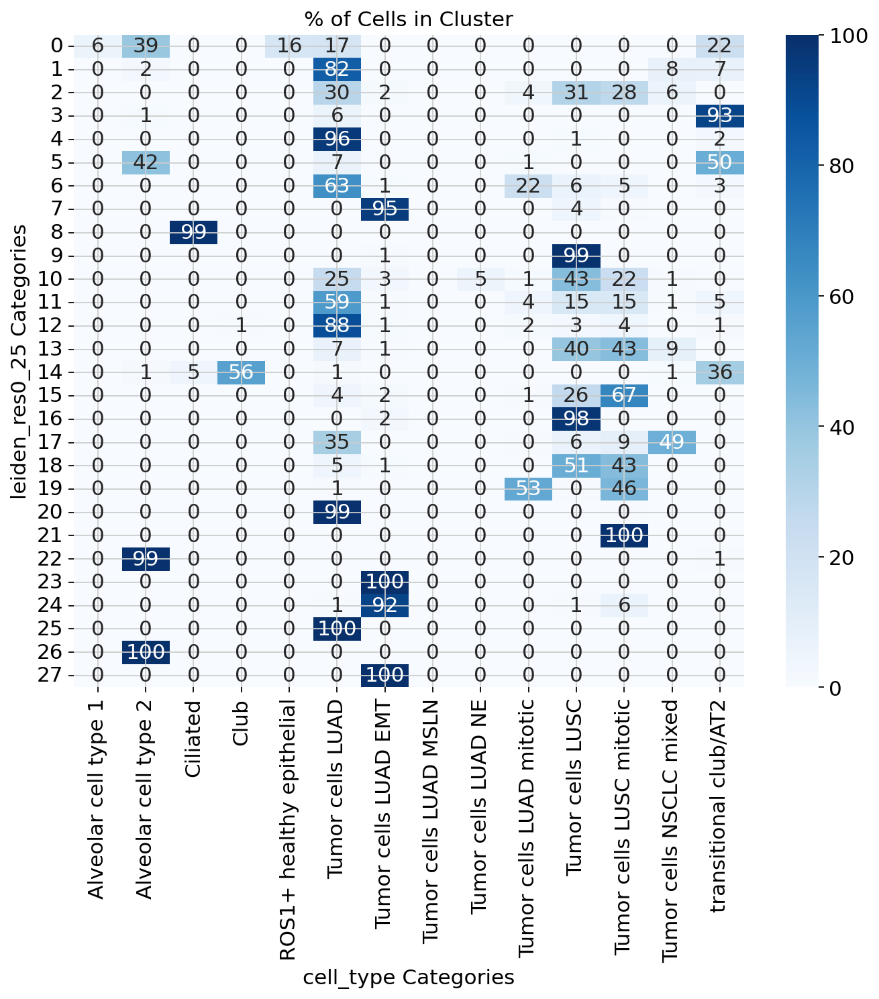

In [247]:
import anndata as ad
import numpy as np
import pandas as pd
from sklearn.metrics import confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming `adata` is your AnnData object and the two obs columns are 'col1' and 'col2'
# Replace 'col1' and 'col2' with your actual column names
col1 = 'leiden_res0_25'
col2 = 'cell_type'

# Extract the two columns from the obs dataframe
labels1 = ref_latent_tumor.obs[col1]
labels2 = ref_latent_tumor.obs[col2]

contingency_table = pd.crosstab(labels1, labels2)
# Normalize the table to get percentages
contingency_table_percentage = contingency_table.div(contingency_table.sum(axis=1), axis=0) * 100

# Visualize the matrix using seaborn
plt.figure(figsize=(10, 8))
sns.heatmap(contingency_table_percentage, annot=True, fmt='.0f', cmap='Blues')
plt.xlabel(f'{col2} Categories')
plt.ylabel(f'{col1} Categories')
plt.title('% of Cells in Cluster')
plt.show()


## Hierarchical tree for new cancer cell types

We want to extract a hierarchy of cancer cell types starting from healthy epithelial ones. One idea is to do this via the methodology of treeArches,
where a learned hierarchy is updated by creating new clusters when the FNR (flase negative rate) of cluster division is higher than a given threshold (See Fig below).
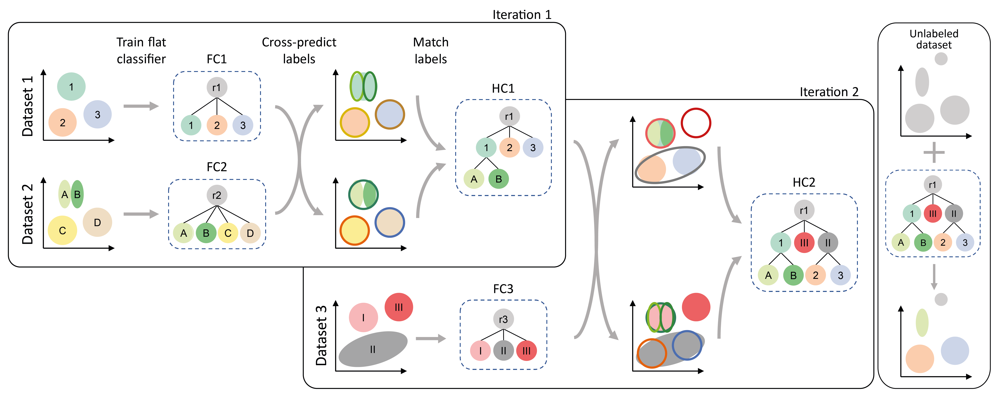

The problem is that we want to have cell types that are mostly present in all our samples, so that their mutual information with other cell types is relevant.

The treeArches procedure creates new types by **iteratively** adding new datasets or samples. In their latest article [Michielsen & Mafouz 2023](https://doi.org/10.1093/nargab/lqad070) they claim the order of operations is not relevant when annotating new cell types, but when digging further [Lotfollahi & Luecken 2022](https://rdcu.be/dVnHR) this claim is valid for query annotation when the only weights changed are on the first layer and for the cells of the new samples (what they call adaptors).

Also, when they tried discovering new cell types like the COVID infected cells, they explicitly avoided signaling the disease in the integration to the autoencoder, so as not to correct for this in the batch covariates and leave the finding of new cell types to the hypothesis testing or label transfer distance.

That is why we choose to learn a tree representation with an integrated reference atlas, that captures the major batch effects but only for epithelial and tumor cells. And new datasets will only be predicted and no new tree trained.

In [33]:
list(ref_latent_tumor.obs.batch.unique())

['Chen_Zhang_2020',
 'Kim_Lee_2020',
 'He_Fan_2021',
 'Lambrechts_Thienpont_2018_6149v1',
 'Lambrechts_Thienpont_2018_6149v2',
 'Lambrechts_Thienpont_2018_6653',
 'Laughney_Massague_2020',
 'Maynard_Bivona_2020',
 'UKIM-V',
 'Wu_Zhou_2021',
 'Zilionis_Klein_2019',
 'UKIM-V-2']

Starting tree:


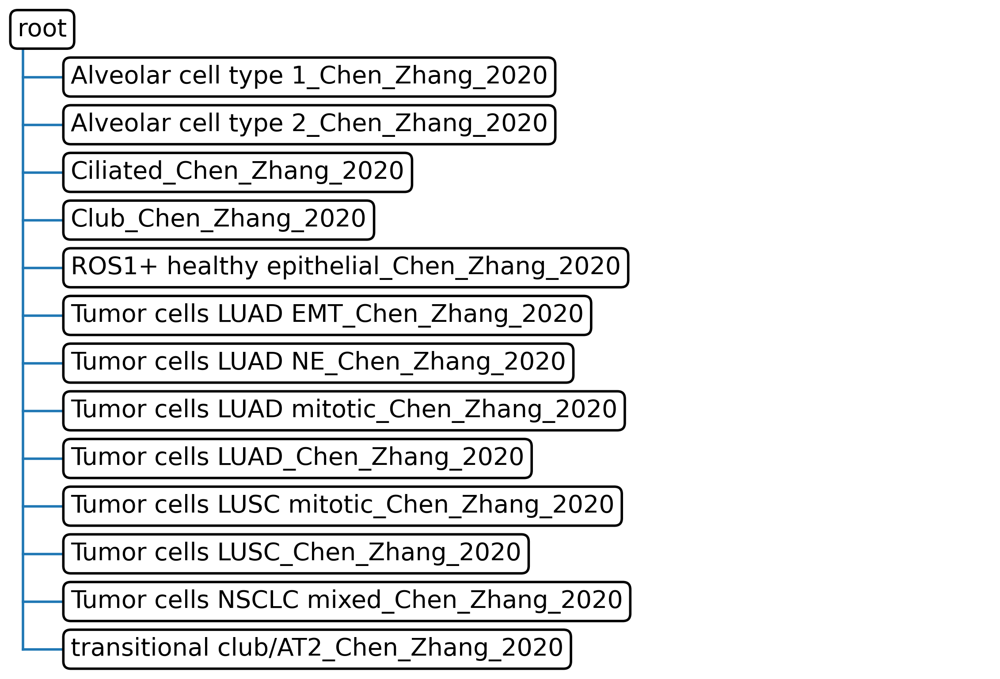


Adding dataset Kim_Lee_2020 to the tree


/usr/local/lib/python3.11/site-packages/sklearn/model_selection/_split.py:776: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(
/usr/local/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/usr/local/lib/python3.11/site-packages/numpy/core/_methods.py:121: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
/usr/local/lib/python3.11/site-packages/sklearn/model_selection/_split.py:776: UserWarning: The least populated class in y has only 4 members, which is less than n_splits=5.
  warnings.warn(


These populations are missing from the tree: 
['Tumor cells LUAD EMT_Kim_Lee_2020' 'Tumor cells LUAD_Kim_Lee_2020'
 'Tumor cells NSCLC mixed_Kim_Lee_2020']

Updated tree:


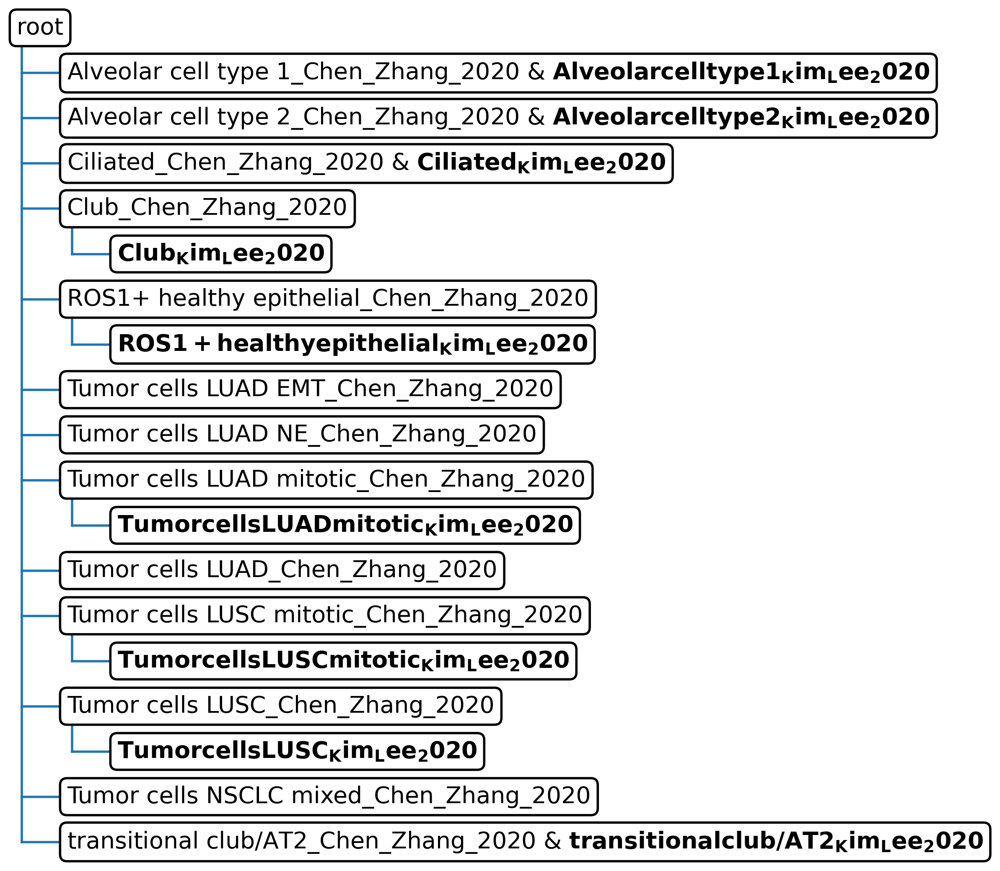


Adding dataset He_Fan_2021 to the tree


/usr/local/lib/python3.11/site-packages/sklearn/model_selection/_split.py:776: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(
/usr/local/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/usr/local/lib/python3.11/site-packages/numpy/core/_methods.py:121: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
/usr/local/lib/python3.11/site-packages/sklearn/model_selection/_split.py:776: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(
/usr/local/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/usr/local/lib/python3.11/site-packages/numpy/core/_methods.py:121: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(



Updated tree:


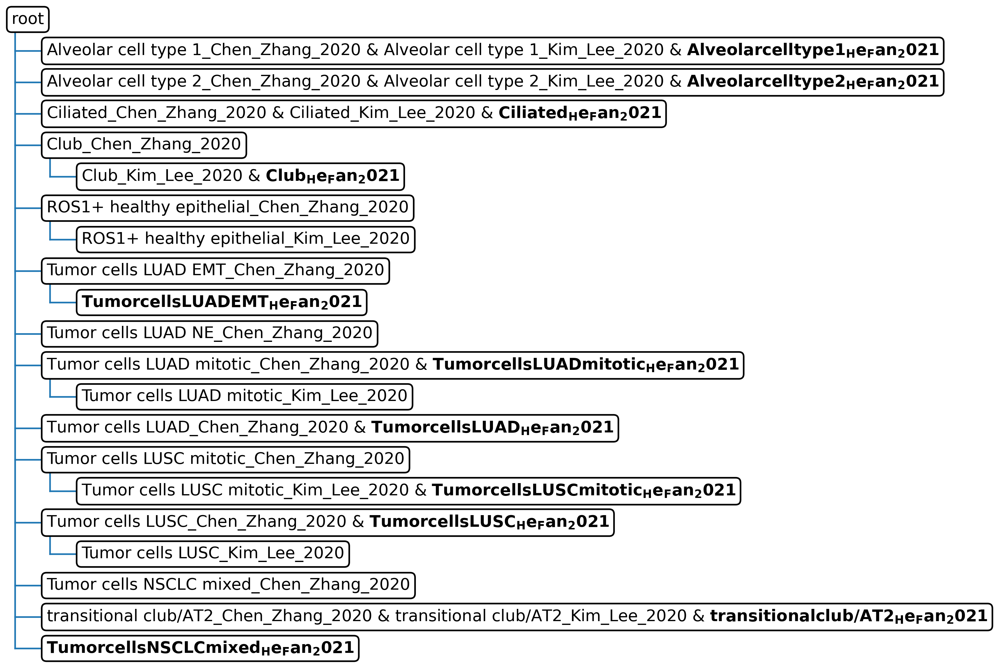


Adding dataset Lambrechts_Thienpont_2018_6149v1 to the tree


/usr/local/lib/python3.11/site-packages/sklearn/model_selection/_split.py:776: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(
/usr/local/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/usr/local/lib/python3.11/site-packages/numpy/core/_methods.py:121: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
/usr/local/lib/python3.11/site-packages/sklearn/model_selection/_split.py:776: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(
/usr/local/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/usr/local/lib/python3.11/site-packages/numpy/core/_methods.py:121: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(


These populations are missing from the tree: 
['Tumor cells LUAD mitotic_Lambrechts_Thienpont_2018_6149v1'
 'Tumor cells LUAD_Lambrechts_Thienpont_2018_6149v1'
 'Tumor cells NSCLC mixed_Lambrechts_Thienpont_2018_6149v1']

Updated tree:


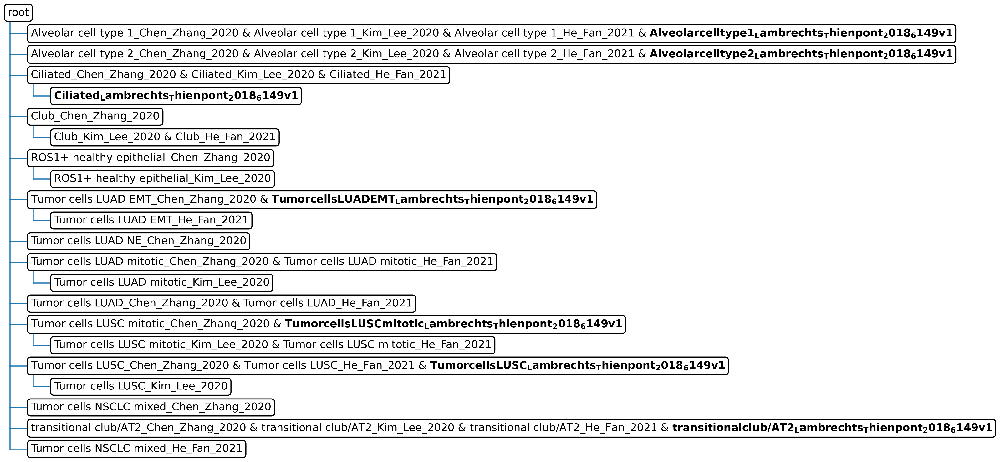


Adding dataset Lambrechts_Thienpont_2018_6149v2 to the tree


/usr/local/lib/python3.11/site-packages/sklearn/model_selection/_split.py:776: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(
/usr/local/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/usr/local/lib/python3.11/site-packages/numpy/core/_methods.py:121: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
/usr/local/lib/python3.11/site-packages/sklearn/model_selection/_split.py:776: UserWarning: The least populated class in y has only 2 members, which is less than n_splits=5.
  warnings.warn(


These populations are missing from the tree: 
['ROS1+ healthy epithelial_Lambrechts_Thienpont_2018_6149v2']

Updated tree:


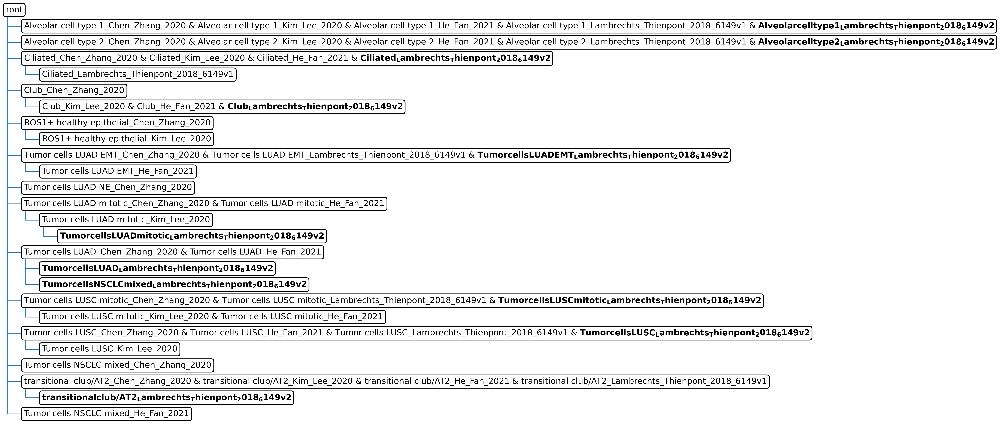


Adding dataset Lambrechts_Thienpont_2018_6653 to the tree


/usr/local/lib/python3.11/site-packages/sklearn/model_selection/_split.py:776: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(
/usr/local/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/usr/local/lib/python3.11/site-packages/numpy/core/_methods.py:121: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(


These populations are missing from the tree: 
['Tumor cells LUAD EMT_Lambrechts_Thienpont_2018_6653'
 'Tumor cells LUAD_Lambrechts_Thienpont_2018_6653'
 'Tumor cells NSCLC mixed_Lambrechts_Thienpont_2018_6653']

Updated tree:


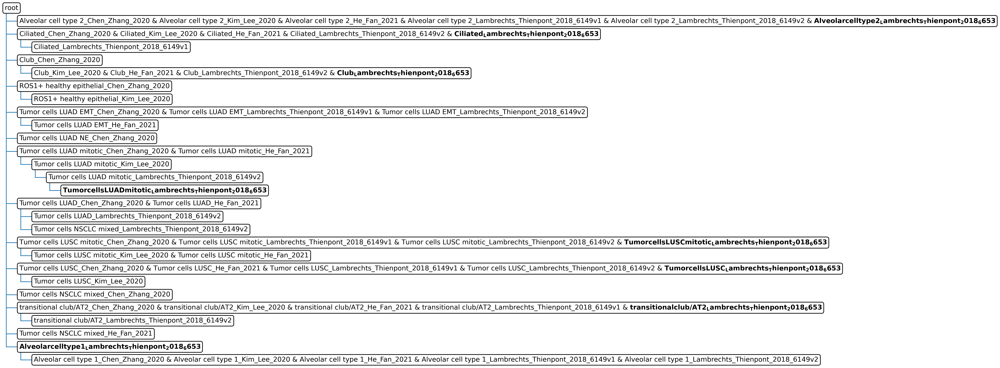


Adding dataset Laughney_Massague_2020 to the tree


/usr/local/lib/python3.11/site-packages/sklearn/model_selection/_split.py:776: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(
/usr/local/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/usr/local/lib/python3.11/site-packages/numpy/core/_methods.py:121: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
/usr/local/lib/python3.11/site-packages/sklearn/model_selection/_split.py:776: UserWarning: The least populated class in y has only 2 members, which is less than n_splits=5.
  warnings.warn(


These populations are missing from the tree: 
['Tumor cells LUAD EMT_Laughney_Massague_2020'
 'Tumor cells LUAD_Laughney_Massague_2020'
 'Tumor cells LUSC_Laughney_Massague_2020'
 'Tumor cells NSCLC mixed_Laughney_Massague_2020']

Updated tree:


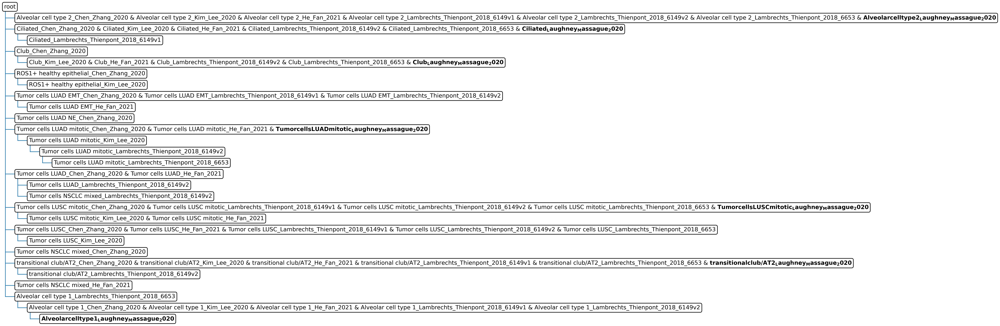


Adding dataset Maynard_Bivona_2020 to the tree


/usr/local/lib/python3.11/site-packages/sklearn/model_selection/_split.py:776: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(
/usr/local/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/usr/local/lib/python3.11/site-packages/numpy/core/_methods.py:121: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
/usr/local/lib/python3.11/site-packages/sklearn/model_selection/_split.py:776: UserWarning: The least populated class in y has only 2 members, which is less than n_splits=5.
  warnings.warn(


These populations are missing from the tree: 
['Tumor cells LUAD mitotic_Maynard_Bivona_2020'
 'Tumor cells LUAD_Maynard_Bivona_2020'
 'Tumor cells LUSC mitotic_Maynard_Bivona_2020'
 'Tumor cells LUSC_Maynard_Bivona_2020'
 'Tumor cells NSCLC mixed_Maynard_Bivona_2020']

Updated tree:


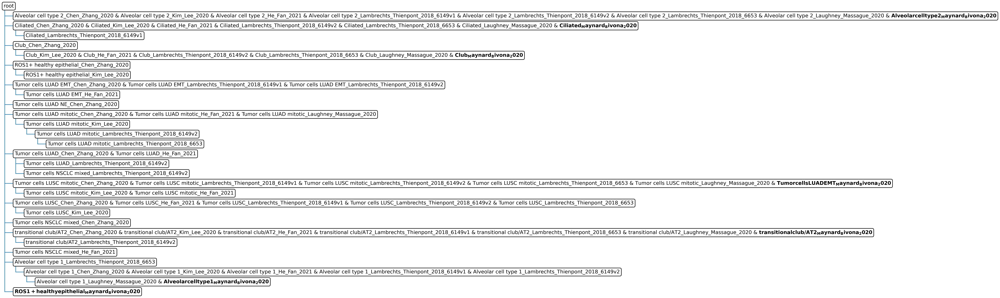


Adding dataset UKIM-V to the tree


/usr/local/lib/python3.11/site-packages/sklearn/model_selection/_split.py:776: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(
/usr/local/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/usr/local/lib/python3.11/site-packages/numpy/core/_methods.py:121: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(


These populations are missing from the tree: 
['Tumor cells LUAD_UKIM-V' 'Tumor cells NSCLC mixed_UKIM-V']

Updated tree:


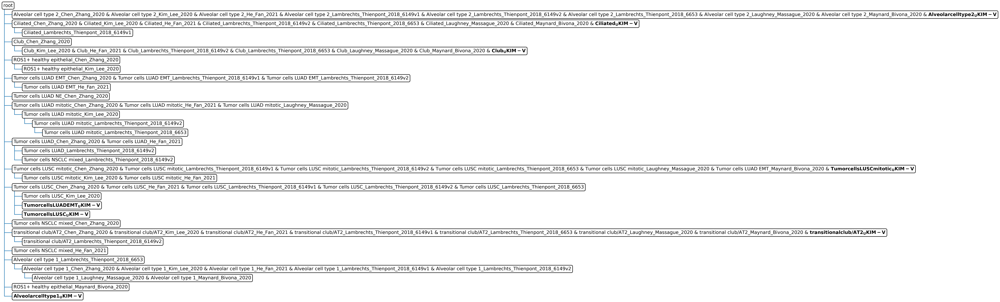


Adding dataset Wu_Zhou_2021 to the tree


/usr/local/lib/python3.11/site-packages/sklearn/model_selection/_split.py:776: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(
/usr/local/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/usr/local/lib/python3.11/site-packages/numpy/core/_methods.py:121: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(


These populations are missing from the tree: 
['Tumor cells LUAD NE_Wu_Zhou_2021' 'Tumor cells LUAD_Wu_Zhou_2021'
 'Tumor cells NSCLC mixed_Wu_Zhou_2021']

Updated tree:



Adding dataset Zilionis_Klein_2019 to the tree


/usr/local/lib/python3.11/site-packages/sklearn/model_selection/_split.py:776: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(
/usr/local/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/usr/local/lib/python3.11/site-packages/numpy/core/_methods.py:121: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
/usr/local/lib/python3.11/site-packages/sklearn/model_selection/_split.py:776: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(
/usr/local/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/usr/local/lib/python3.11/site-packages/numpy/core/_methods.py:121: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(


These populations are missing from the tree: 
['Tumor cells LUAD NE_Zilionis_Klein_2019'
 'Tumor cells LUAD_Zilionis_Klein_2019'
 'Tumor cells NSCLC mixed_Zilionis_Klein_2019']

Updated tree:



Adding dataset UKIM-V-2 to the tree


/usr/local/lib/python3.11/site-packages/sklearn/model_selection/_split.py:776: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(
/usr/local/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/usr/local/lib/python3.11/site-packages/numpy/core/_methods.py:121: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(


These populations are missing from the tree: 
['Tumor cells LUAD MSLN_UKIM-V-2' 'Tumor cells LUAD NE_UKIM-V-2'
 'Tumor cells LUAD_UKIM-V-2' 'Tumor cells LUSC mitotic_UKIM-V-2'
 'Tumor cells NSCLC mixed_UKIM-V-2']

Updated tree:


/usr/local/lib/python3.11/site-packages/sklearn/model_selection/_split.py:776: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(
/usr/local/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/usr/local/lib/python3.11/site-packages/numpy/core/_methods.py:121: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(


In [45]:
batch_order = ['Chen_Zhang_2020',
 'Kim_Lee_2020',
 'He_Fan_2021',
 'Lambrechts_Thienpont_2018_6149v1',
 'Lambrechts_Thienpont_2018_6149v2',
 'Lambrechts_Thienpont_2018_6653',
 'Laughney_Massague_2020',
 'Maynard_Bivona_2020',
 'UKIM-V',
 'Wu_Zhou_2021',
 'Zilionis_Klein_2019',
 'UKIM-V-2']

tree_ref, mp_ref = sca.classifiers.scHPL.learn_tree(data = ref_latent_tumor,
                batch_key = 'batch',
                batch_order = batch_order, # We choose alphabetical and should try another order after this
                cell_type_key='celltype_batch',
                classifier = 'knn', dynamic_neighbors=True,
                dimred = False, print_conf= False, attach_missing=True)

In [40]:
sum(ref_latent_tumor.obs['celltype_batch'] == "Tumor cells LUAD_Maynard_Bivona_2020")

822

We try out with a permutation to confirm that the building of the tree and not consulting like they claim is not commutative. 

I also put Maynard Bivona first to start to understand why Tumor cells LUAD are not present in the tree even though there are around 1k cells predicted as such.

Starting tree:


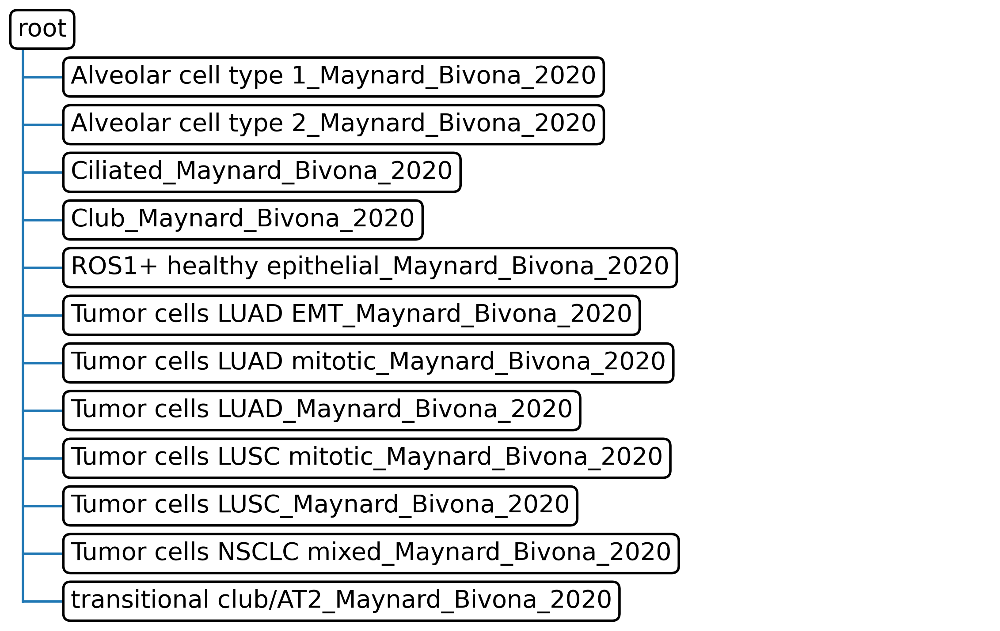


Adding dataset UKIM-V to the tree


/usr/local/lib/python3.11/site-packages/sklearn/model_selection/_split.py:776: UserWarning: The least populated class in y has only 2 members, which is less than n_splits=5.
  warnings.warn(


These populations are missing from the tree: 
['Tumor cells LUAD mitotic_UKIM-V' 'Tumor cells LUAD_UKIM-V'
 'Tumor cells LUSC_UKIM-V']
Missing populations are attached to root

Updated tree:


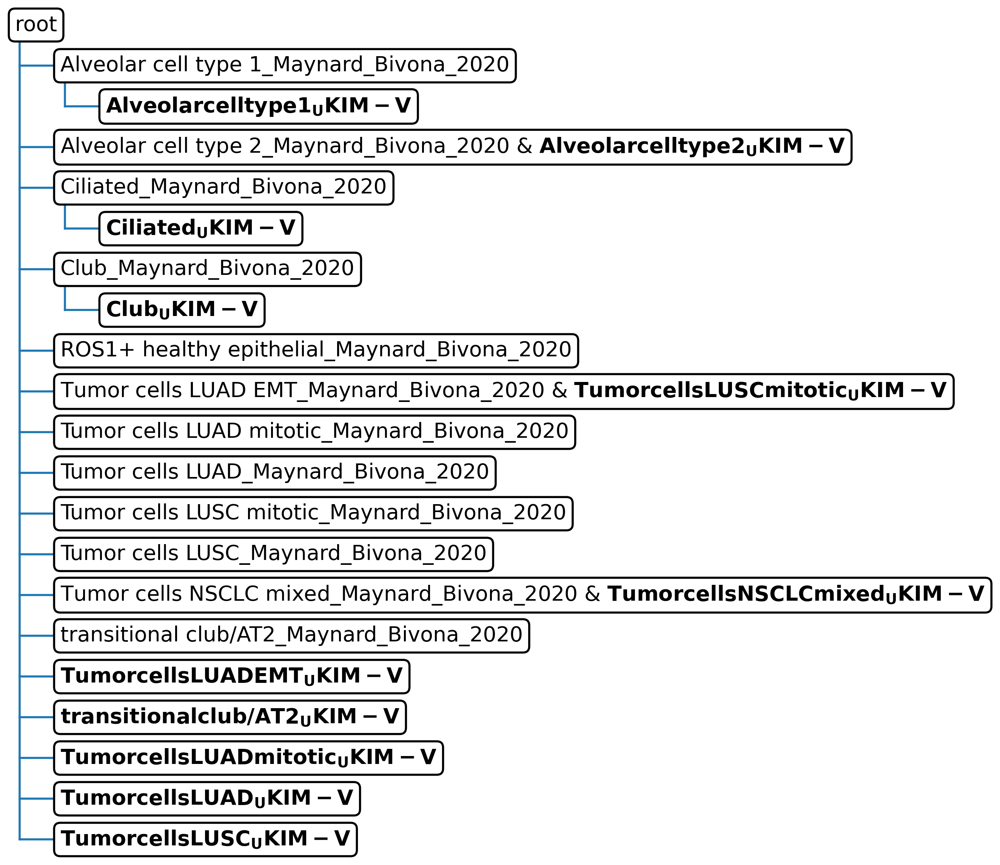


Adding dataset Wu_Zhou_2021 to the tree


/usr/local/lib/python3.11/site-packages/sklearn/model_selection/_split.py:776: UserWarning: The least populated class in y has only 2 members, which is less than n_splits=5.
  warnings.warn(



Updated tree:


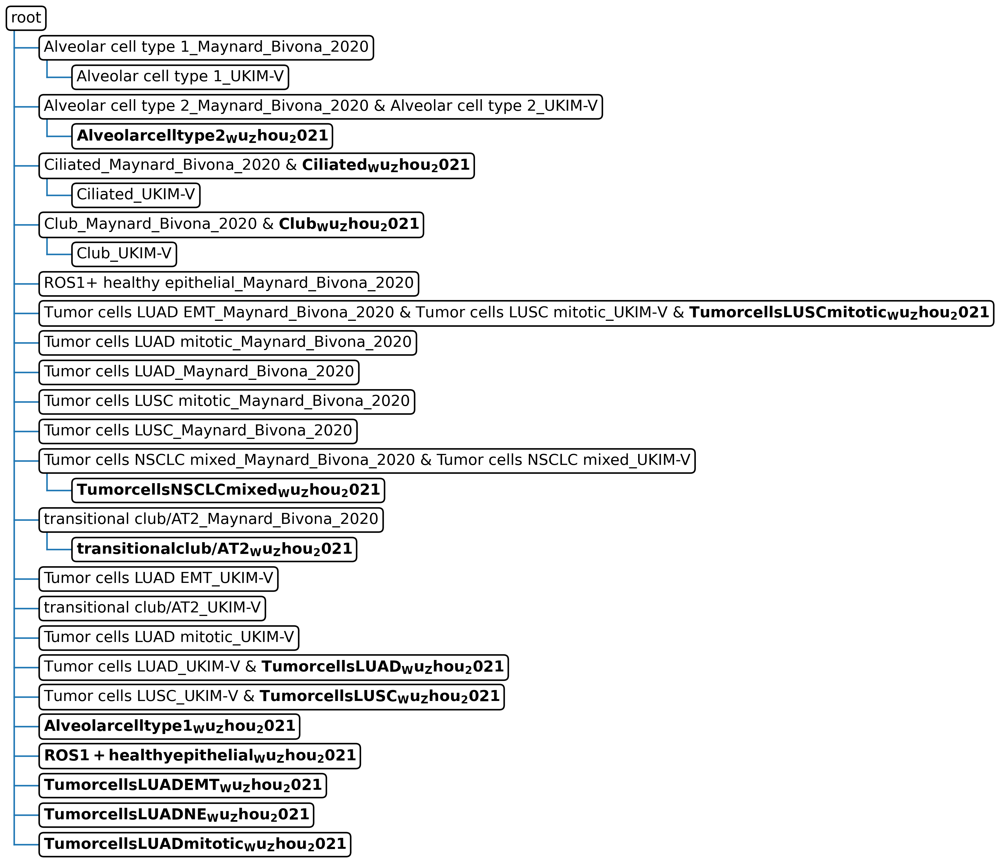


Adding dataset Zilionis_Klein_2019 to the tree


/usr/local/lib/python3.11/site-packages/sklearn/model_selection/_split.py:776: UserWarning: The least populated class in y has only 2 members, which is less than n_splits=5.
  warnings.warn(
/usr/local/lib/python3.11/site-packages/sklearn/model_selection/_split.py:776: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(
/usr/local/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/usr/local/lib/python3.11/site-packages/numpy/core/_methods.py:121: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(



Updated tree:


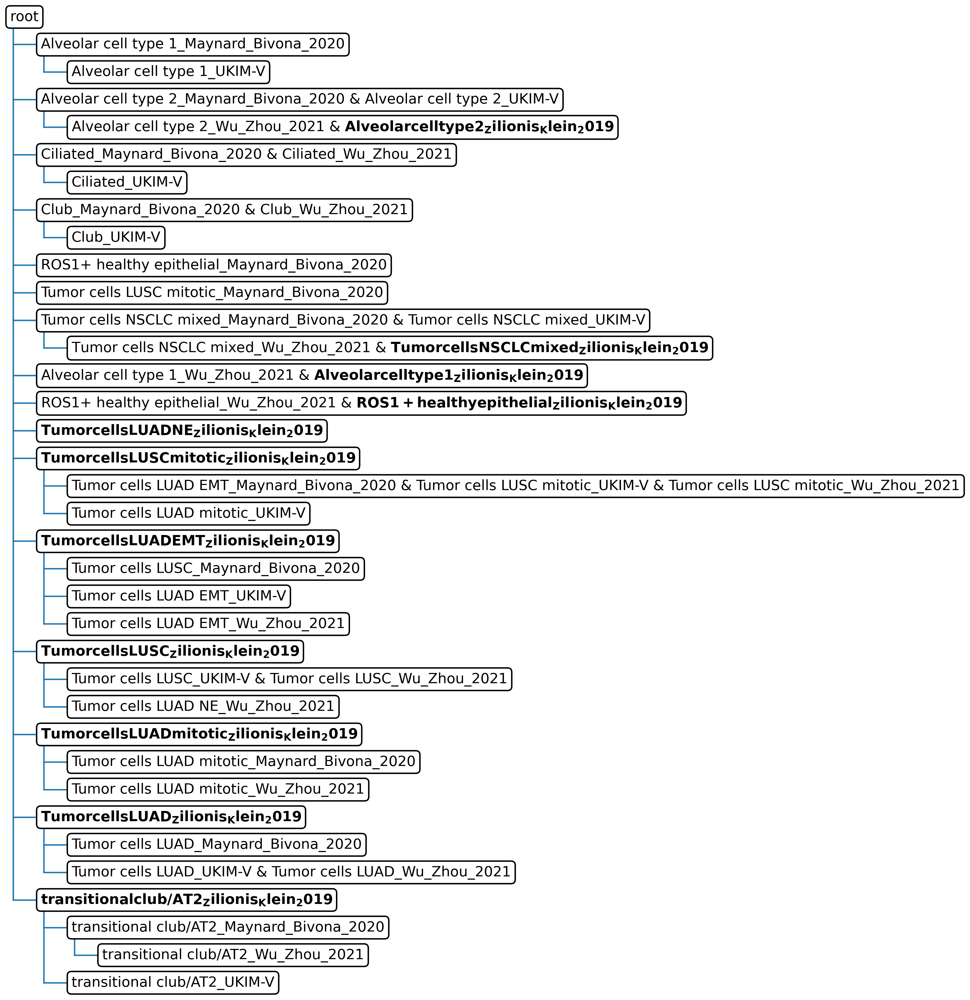


Adding dataset UKIM-V-2 to the tree


/usr/local/lib/python3.11/site-packages/sklearn/model_selection/_split.py:776: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(
/usr/local/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/usr/local/lib/python3.11/site-packages/numpy/core/_methods.py:121: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(


These populations are missing from the tree: 
['Tumor cells LUAD EMT_UKIM-V-2' 'Tumor cells LUAD MSLN_UKIM-V-2'
 'Tumor cells LUAD_UKIM-V-2']
Missing populations are attached to root

Updated tree:


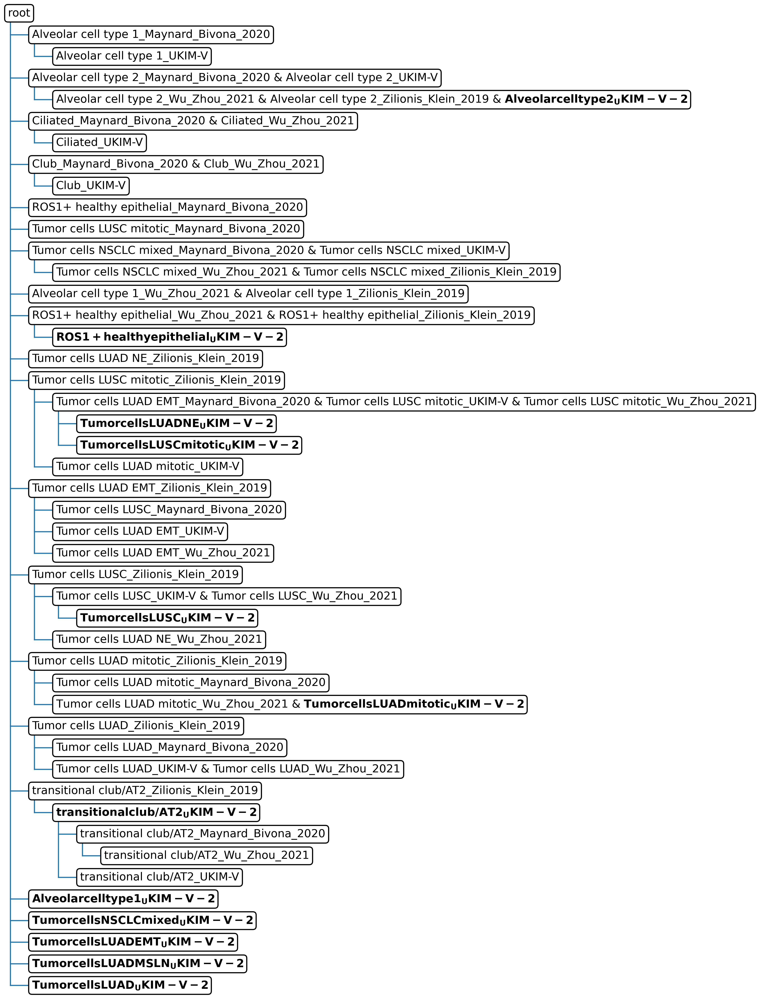


Adding dataset Chen_Zhang_2020 to the tree


/usr/local/lib/python3.11/site-packages/sklearn/model_selection/_split.py:776: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(
/usr/local/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/usr/local/lib/python3.11/site-packages/numpy/core/_methods.py:121: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
/usr/local/lib/python3.11/site-packages/sklearn/model_selection/_split.py:776: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(
/usr/local/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/usr/local/lib/python3.11/site-packages/numpy/core/_methods.py:121: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(


These populations are missing from the tree: 
['Tumor cells LUAD mitotic_Chen_Zhang_2020'
 'Tumor cells LUAD_Chen_Zhang_2020'
 'Tumor cells NSCLC mixed_Chen_Zhang_2020']
Missing populations are attached to root

Updated tree:


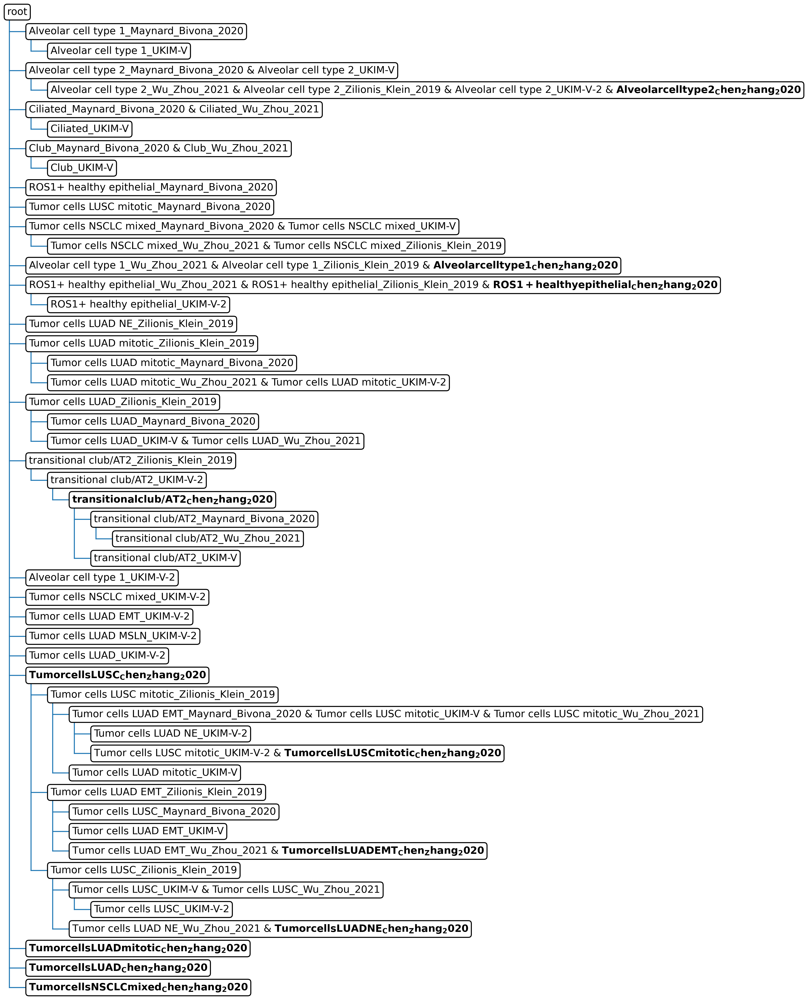


Adding dataset Kim_Lee_2020 to the tree


/usr/local/lib/python3.11/site-packages/sklearn/model_selection/_split.py:776: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(
/usr/local/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/usr/local/lib/python3.11/site-packages/numpy/core/_methods.py:121: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
/usr/local/lib/python3.11/site-packages/sklearn/model_selection/_split.py:776: UserWarning: The least populated class in y has only 4 members, which is less than n_splits=5.
  warnings.warn(


These populations are missing from the tree: 
['Tumor cells LUAD EMT_Kim_Lee_2020' 'Tumor cells LUAD_Kim_Lee_2020']
Missing populations are attached to root

Updated tree:


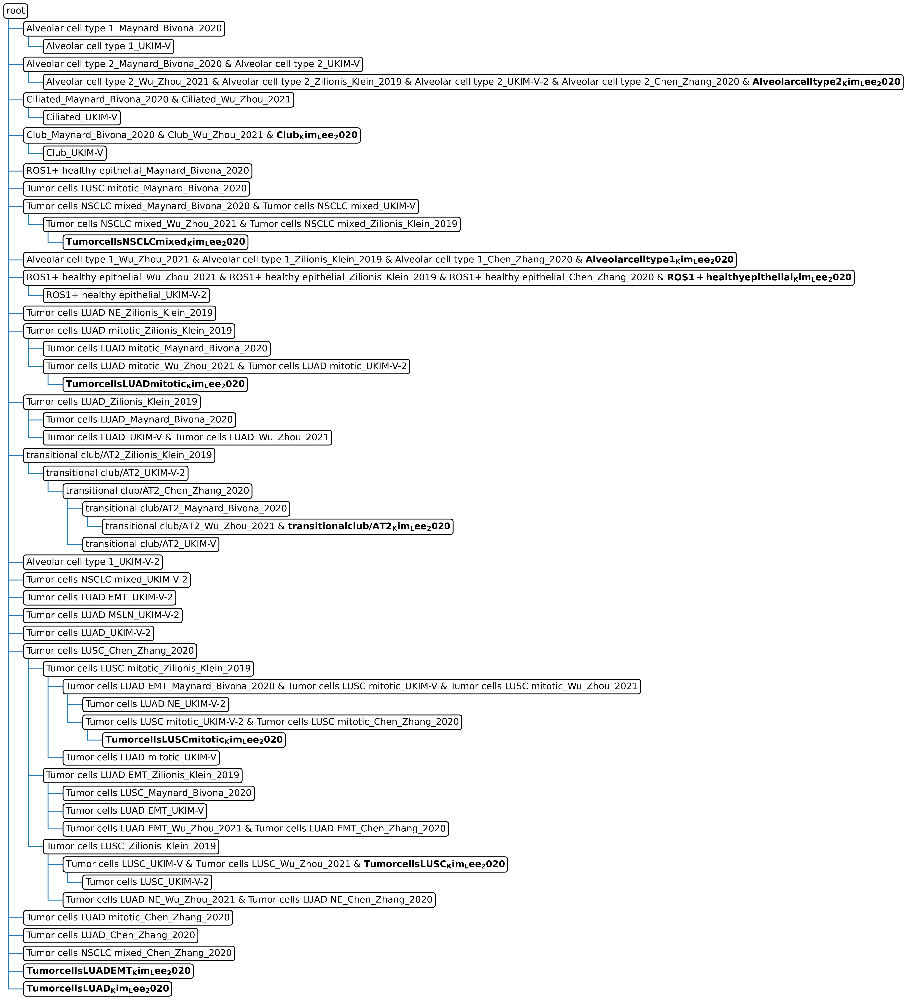


Adding dataset He_Fan_2021 to the tree


/usr/local/lib/python3.11/site-packages/sklearn/model_selection/_split.py:776: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(
/usr/local/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/usr/local/lib/python3.11/site-packages/numpy/core/_methods.py:121: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
/usr/local/lib/python3.11/site-packages/sklearn/model_selection/_split.py:776: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(
/usr/local/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/usr/local/lib/python3.11/site-packages/numpy/core/_methods.py:121: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(


These populations are missing from the tree: 
['Tumor cells LUAD_He_Fan_2021']
Missing populations are attached to root

Updated tree:


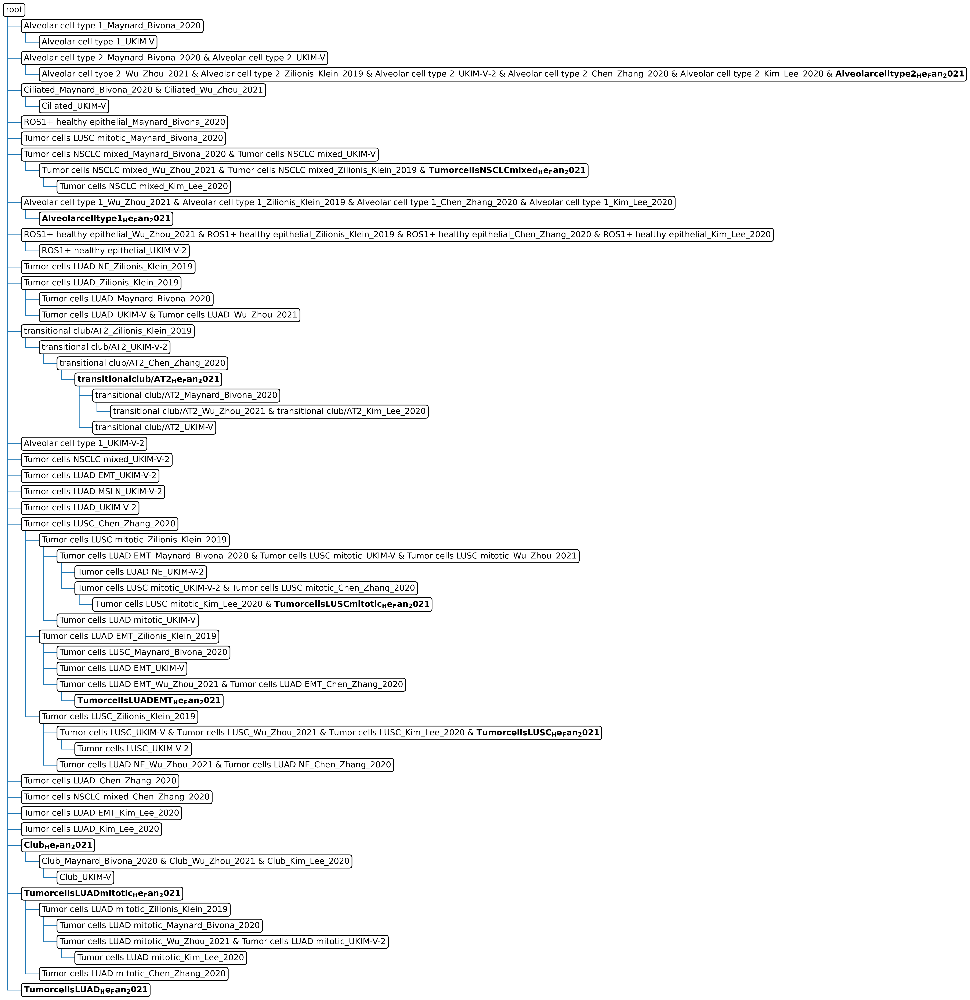


Adding dataset Lambrechts_Thienpont_2018_6149v1 to the tree


/usr/local/lib/python3.11/site-packages/sklearn/model_selection/_split.py:776: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(
/usr/local/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/usr/local/lib/python3.11/site-packages/numpy/core/_methods.py:121: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
/usr/local/lib/python3.11/site-packages/sklearn/model_selection/_split.py:776: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(
/usr/local/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/usr/local/lib/python3.11/site-packages/numpy/core/_methods.py:121: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(



Updated tree:



Adding dataset Lambrechts_Thienpont_2018_6149v2 to the tree


/usr/local/lib/python3.11/site-packages/sklearn/model_selection/_split.py:776: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(
/usr/local/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/usr/local/lib/python3.11/site-packages/numpy/core/_methods.py:121: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
/usr/local/lib/python3.11/site-packages/sklearn/model_selection/_split.py:776: UserWarning: The least populated class in y has only 2 members, which is less than n_splits=5.
  warnings.warn(


IndexError: list index out of range

In [48]:
batch_order2 = ['Maynard_Bivona_2020',
 'UKIM-V',
 'Wu_Zhou_2021',
 'Zilionis_Klein_2019',
 'UKIM-V-2',
 'Chen_Zhang_2020',
 'Kim_Lee_2020',
 'He_Fan_2021',
 'Lambrechts_Thienpont_2018_6149v1',
 'Lambrechts_Thienpont_2018_6149v2',
 'Lambrechts_Thienpont_2018_6653',
 'Laughney_Massague_2020'
 ]

tree_ref2, mp_ref2 = sca.classifiers.scHPL.learn_tree(data = ref_latent_tumor,
                batch_key = 'batch',
                batch_order = batch_order2, # We choose alphabetical and should try another order after this
                cell_type_key='celltype_batch',
                classifier = 'knn', dynamic_neighbors=True,
                dimred = False, print_conf= False, attach_missing=True)

Being in the tree is not only about abundance of cells it also has other factors. Though i don't know why they just dont define a new cluster. Maybe it has to do with the root or a minimum number cells with some distance to the root.

Form reading the article the cells that arenot assigned are also because they belong to mutiple clusters and there is no way to decide between all of them. So they a re just ignored.

From these tow trees one can clearly see that the order does matter.